# Project 2: NYC safety investigation: Spatial Analysis of Gun Violence and Homelessness Reports in New York City (2019–2024)

## Introduction

Using the dataset from NYC open data, I want to explore NYC publice safety+social services area. Does borough-level volume of homeless-related 311 complaints correlate with gun violence incidents? 

- Why this project? Complaints related to homelessness submitted through 311 represent visible signs of socioeconomic hardship and urgent needs on the street level, while shooting incidents are one of the most serious public safety outcomes tracked by the NYPD.

- How? In this project, I will analyze how these two dimensions relate to each other across New York City’s five boroughs from 2019 to 2024. 

- Project Goal: Identify potential associations, and highlight how different indicators of social disorder and public safety could coexist across time and space. 

Data source website

Shooting data: https://data.cityofnewyork.us/Public-Safety/NYPD-Shooting-Incident-Data-Historic-/833y-fsy8/about_data

311 request: https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9/about_data

## Process data

In [2]:
# read data from two csv files
import pandas as pd
import plotly.express as px

shooting = pd.read_csv("NYPD_Shooting_Historic.csv")
shooting.head()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,298699604,12/31/2024,19:16:00,BROOKLYN,OUTSIDE,69,0.0,STREET,(null),False,...,M,BLACK,25-44,M,BLACK,"1,015,120","173,870",40.643866,-73.888761,POINT (-73.888761 40.643866)
1,298699604,12/31/2024,19:16:00,BROOKLYN,OUTSIDE,69,0.0,STREET,(null),False,...,M,BLACK,18-24,M,BLACK,"1,015,120","173,870",40.643866,-73.888761,POINT (-73.888761 40.643866)
2,298672096,12/30/2024,16:45:00,BRONX,OUTSIDE,47,0.0,STREET,(null),False,...,(null),(null),<18,F,WHITE HISPANIC,"1,021,316","259,277",40.878261,-73.865964,POINT (-73.865964 40.878261)
3,298672094,12/30/2024,12:15:00,BRONX,OUTSIDE,52,0.0,STREET,(null),False,...,M,BLACK,25-44,M,WHITE,"1,017,719","260,875",40.882661,-73.878964,POINT (-73.878964 40.882661)
4,298672095,12/30/2024,20:32:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,"1,012,201","240,878",40.827795,-73.899003,POINT (-73.899003 40.827795)


In [3]:
# Before downloading this csv, I had cleaned the data and selected homeless-related complaints only.
homeless = pd.read_csv("Homeless_311_since_01012019.csv", low_memory=False)
homeless.head()

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Vehicle Type,Taxi Company Borough,Taxi Pick Up Location,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Latitude,Longitude,Location
0,62606550,09/30/2024 01:46:04 AM,NaN,DHS,Department of Homeless Services,Homeless Person Assistance,Non-Chronic,Store/Commercial,10107.0,250 WEST 57 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.766391,-73.982119,"(40.76639057686906, -73.98211943675079)"
1,62603742,09/30/2024 01:38:59 AM,NaN,DHS,Department of Homeless Services,Homeless Person Assistance,Non-Chronic,Residential Building/House,10013.0,105 READE STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.715743,-74.008243,"(40.71574277769142, -74.00824268927197)"
2,62605770,09/30/2024 01:23:02 AM,NaN,DHS,Department of Homeless Services,Homeless Person Assistance,Non-Chronic,Other,10301.0,18 RICHMOND TERRACE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.643004,-74.075772,"(40.64300357766563, -74.07577170286257)"
3,62606623,09/30/2024 01:15:46 AM,NaN,DHS,Department of Homeless Services,Homeless Person Assistance,Non-Chronic,Other,10013.0,60 LAFAYETTE STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.716459,-74.002327,"(40.716459431762694, -74.0023267359905)"
4,62607487,09/30/2024 01:03:31 AM,09/30/2024 01:30:55 AM,DHS,Department of Homeless Services,Homeless Person Assistance,Chronic,Subway,NaN,NaN,...,NaN,NaN,NaN,F,F M Uptown & Queens,NaN,Platform,40.742878,-73.992822,"(40.74287750319516, -73.99282215047695)"


In [4]:
# Clean data for homeless complaints. We only need a few columns that are usefull for our analysis.
cols_homeless = [
    "Unique Key",
    "Created Date",
    "Complaint Type",
    "Borough",
    "Longitude",
    "Latitude",
]
homeless_v2 = homeless[cols_homeless].copy()
homeless_v2.head()

,Unique Key,Created Date,Complaint Type,Borough,Longitude,Latitude
0,62606550,09/30/2024 01:46:04 AM,Homeless Person Assistance,MANHATTAN,-73.982119,40.766391
1,62603742,09/30/2024 01:38:59 AM,Homeless Person Assistance,MANHATTAN,-74.008243,40.715743
2,62605770,09/30/2024 01:23:02 AM,Homeless Person Assistance,STATEN ISLAND,-74.075772,40.643004
3,62606623,09/30/2024 01:15:46 AM,Homeless Person Assistance,MANHATTAN,-74.002327,40.716459
4,62607487,09/30/2024 01:03:31 AM,Homeless Person Assistance,MANHATTAN,-73.992822,40.742878


In [5]:
# Clean data for shooting incidents.Same criteria as above.
cols_shooting = ["INCIDENT_KEY", "OCCUR_DATE", "BORO", "Longitude", "Latitude"]
shooting_v2 = shooting[cols_shooting].copy()
shooting_v2.head()

,INCIDENT_KEY,OCCUR_DATE,BORO,Longitude,Latitude
0,298699604,12/31/2024,BROOKLYN,-73.888761,40.643866
1,298699604,12/31/2024,BROOKLYN,-73.888761,40.643866
2,298672096,12/30/2024,BRONX,-73.865964,40.878261
3,298672094,12/30/2024,BRONX,-73.878964,40.882661
4,298672095,12/30/2024,BRONX,-73.899003,40.827795


In [6]:
# Change date to datetime+year format for both datasets
homeless_v2["Created Date"] = pd.to_datetime(
    homeless_v2["Created Date"], errors="coerce"
).dt.date
homeless_v2 = homeless_v2[homeless_v2["Created Date"].notna()]
homeless_v2["year"] = pd.to_datetime(homeless_v2["Created Date"]).dt.year
# filter years between 2019 and 2024
homeless_clean = homeless_v2[
    (homeless_v2["year"] >= 2019) & (homeless_v2["year"] <= 2024)
]
homeless_clean.head()

,Unique Key,Created Date,Complaint Type,Borough,Longitude,Latitude,year
0,62606550,2024-09-30,Homeless Person Assistance,MANHATTAN,-73.982119,40.766391,2024
1,62603742,2024-09-30,Homeless Person Assistance,MANHATTAN,-74.008243,40.715743,2024
2,62605770,2024-09-30,Homeless Person Assistance,STATEN ISLAND,-74.075772,40.643004,2024
3,62606623,2024-09-30,Homeless Person Assistance,MANHATTAN,-74.002327,40.716459,2024
4,62607487,2024-09-30,Homeless Person Assistance,MANHATTAN,-73.992822,40.742878,2024


In [7]:
# Clean date for shooting dataset
shooting_v2["OCCUR_DATE"] = pd.to_datetime(
    shooting_v2["OCCUR_DATE"], errors="coerce"
).dt.date
shooting_v2 = shooting_v2[shooting_v2["OCCUR_DATE"].notna()]
shooting_v2["year"] = pd.to_datetime(shooting_v2["OCCUR_DATE"]).dt.year
shooting_clean = shooting_v2[
    (shooting_v2["year"] >= 2019) & (shooting_v2["year"] <= 2024)
]

shooting_clean.head()


,INCIDENT_KEY,OCCUR_DATE,BORO,Longitude,Latitude,year
0,298699604,2024-12-31,BROOKLYN,-73.888761,40.643866,2024
1,298699604,2024-12-31,BROOKLYN,-73.888761,40.643866,2024
2,298672096,2024-12-30,BRONX,-73.865964,40.878261,2024
3,298672094,2024-12-30,BRONX,-73.878964,40.882661,2024
4,298672095,2024-12-30,BRONX,-73.899003,40.827795,2024


In [8]:
# Check if borough colomns have null values
homeless_clean["Borough"].value_counts()

Borough
MANHATTAN        130671
BROOKLYN          37954
QUEENS            28109
BRONX             10944
STATEN ISLAND      2027
Unspecified         249
Name: count, dtype: int64

In [9]:
# Clear out null values and unspecified values.
homeless_clean = homeless_clean[
    (homeless_clean["Borough"].notna()) & (homeless_clean["Borough"] != "Unspecified")
]
homeless_clean["Borough"].value_counts()

Borough
MANHATTAN        130671
BROOKLYN          37954
QUEENS            28109
BRONX             10944
STATEN ISLAND      2027
Name: count, dtype: int64

In [10]:
# Check shooting dataset for null values.
shooting_clean["BORO"].value_counts()

BORO
BROOKLYN         3142
BRONX            2904
MANHATTAN        1473
QUEENS           1353
STATEN ISLAND     202
Name: count, dtype: int64

In [11]:
# Align column names for both datasets
shooting_clean = shooting_clean.rename(columns={"BORO": "Borough"})
shooting_clean = shooting_clean.rename(columns={"OCCUR_DATE": "Created Date"})
shooting_clean.head()

,INCIDENT_KEY,Created Date,Borough,Longitude,Latitude,year
0,298699604,2024-12-31,BROOKLYN,-73.888761,40.643866,2024
1,298699604,2024-12-31,BROOKLYN,-73.888761,40.643866,2024
2,298672096,2024-12-30,BRONX,-73.865964,40.878261,2024
3,298672094,2024-12-30,BRONX,-73.878964,40.882661,2024
4,298672095,2024-12-30,BRONX,-73.899003,40.827795,2024


In [12]:
# Now we have two clean and clear datasets and ready to analyze. Firstly we will group the data by year and borough.
shootings_by_boro_year = (
    shooting_clean.groupby(["Borough", "year"])
    .size()
    .reset_index(name="shooting_count")
)

shootings_by_boro_year.head()


,Borough,year,shooting_count
0,BRONX,2019,267
1,BRONX,2020,504
2,BRONX,2021,701
3,BRONX,2022,535
4,BRONX,2023,439


In [13]:
homeless_by_boro_year = (
    homeless_clean.groupby(["Borough", "year"])
    .size()
    .reset_index(name="homeless_count")
)

homeless_by_boro_year.head()


,Borough,year,homeless_count
0,BRONX,2019,1493
1,BRONX,2020,2200
2,BRONX,2021,2176
3,BRONX,2022,1772
4,BRONX,2023,1975


In [14]:
# Merge two datasets together
merged = pd.merge(
    shootings_by_boro_year, homeless_by_boro_year, on=["Borough", "year"], how="inner"
)
merged.head()

,Borough,year,shooting_count,homeless_count
0,BRONX,2019,267,1493
1,BRONX,2020,504,2200
2,BRONX,2021,701,2176
3,BRONX,2022,535,1772
4,BRONX,2023,439,1975


## Data Visualization

### Borough-level scatter plot from 2019-2024
In this graph I want to examine the relationship between two datesets, and scatterplots can help identify the trends clearly.

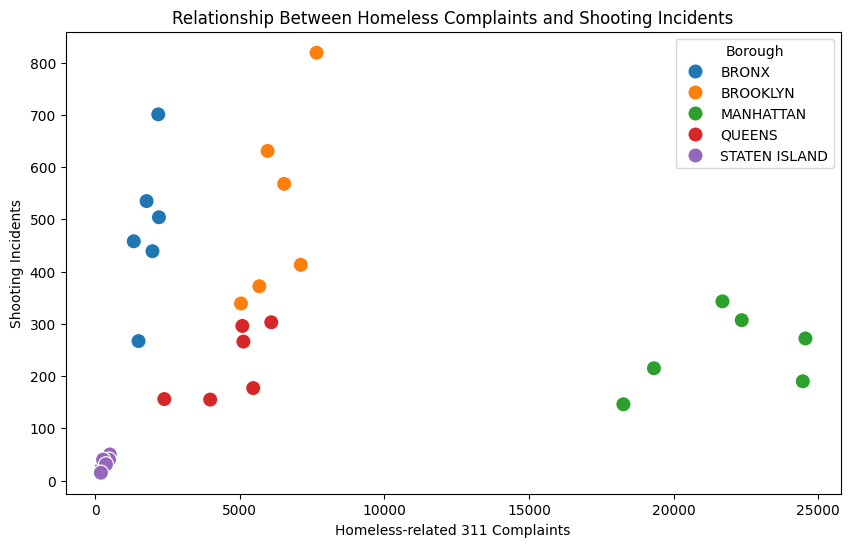

In [ ]:
# Plot the relationship between homeless complaints and shooting incidents by borough and year
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=merged,
    x="homeless_count",
    y="shooting_count",
    hue="Borough",
    s=120,
    palette="tab10",  # Use a different color palette for better visibility
)

plt.title("Relationship Between Homeless Complaints and Shooting Incidents")
plt.xlabel("Homeless-related 311 Complaints")
plt.ylabel("Shooting Incidents")
plt.show()

The scatterplot suggests that the relationship between homelessness-related 311 complaints and shooting incidents varies significantly across boroughs.

- Bronx and Brooklyn show a relatively strong positive association, where higher homeless complaint volume tends to coincide with higher shooting incidents.
- Queens shows a weaker positive trend.
- Manhattan exhibits high homeless complaint levels but comparatively low shooting incidents, suggesting a weak or even negative relationship.
- Staten Island shows very low counts in both metrics, making correlation less remarkable.

### Double-axis line chart by year

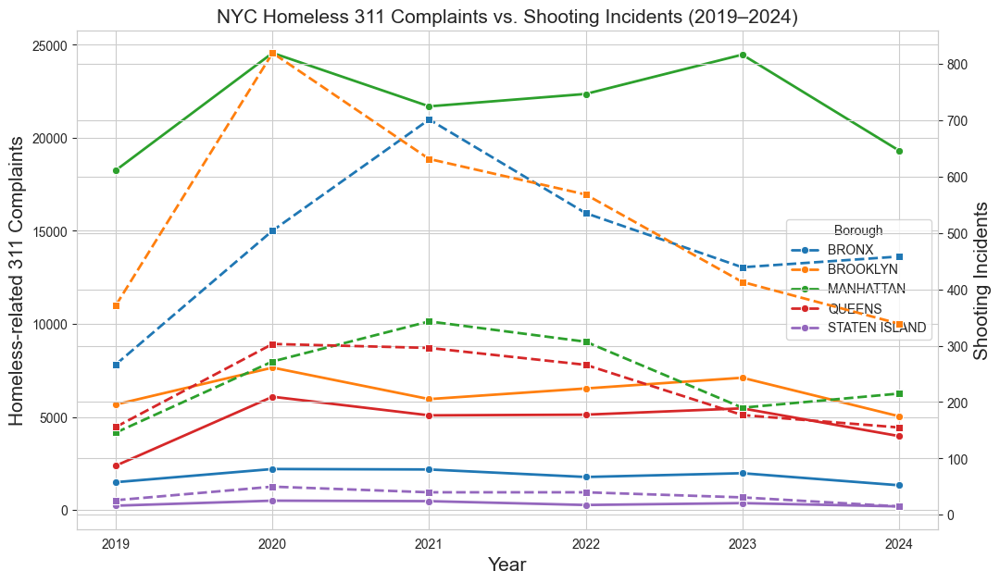

In [ ]:
# Plot the trends over time for each borough
plt.figure(figsize=(12, 7))
sns.set_style("whitegrid")

# Left Y-axis: Homeless 311 complaints
ax1 = sns.lineplot(
    data=merged,
    x="year",
    y="homeless_count",
    hue="Borough",
    marker="o",
    linewidth=2,
    palette="tab10",
)
ax1.set_ylabel("Homeless-related 311 Complaints", fontsize=15)
ax1.set_xlabel("Year", fontsize=15)

# Right Y-axis: Shooting incidents
ax2 = ax1.twinx()
sns.lineplot(
    data=merged,
    x="year",
    y="shooting_count",
    hue="Borough",
    marker="s",
    linestyle="--",
    legend=False,
    linewidth=2,
    palette="tab10",
    ax=ax2,
)
ax2.set_ylabel("Shooting Incidents", fontsize=15)

plt.title("NYC Homeless 311 Complaints vs. Shooting Incidents (2019–2024)", fontsize=15)
plt.show()


This visualization reveals that the relationship between homelessness-related 311 complaints and shooting incidents in NYC is **borough-specific** rather than uniform across the city.

- Bronx and Brooklyn show strong co-movement: both homelessness complaints and shootings rise sharply during 2020–2021 and then decline together through 2024. This suggests that in these boroughs, visible street-level distress and violent crime may reflect shared socioeconomic indicators.
- Queens displays a moderate parallel trend, indicating certain association could exist but weaker overall comparing with Bronx and Brooklyn.
- Manhattan shows a clear divergence: homelessness complaints are by far the highest in the city, yet shootings remain relatively low. This could be explained since Manhattan is more tourism-centered and homeless visibility doesn't necessarily predict violent shooting crimes.
- Staten Island has low levels for both metrics, making trend relationships inconclusive. And this seems to be relatively the safest borough.  

### Two-layer map in 2019 and 2024 (shooting+homeless)

In [ ]:
# Firstly I will filter the data in 2019 first and then 2024 to see a 5-year difference. To achieve that, I will use folium to plot the data on a map of NYC.
import folium

year_to_plot = 2019

shooting_year = shooting_clean[shooting_clean["year"] == year_to_plot]
homeless_year = homeless_clean[homeless_clean["year"] == year_to_plot]

len(shooting_year), len(homeless_year)

(967, 28128)

In [ ]:
# Set up the map centered on NYC
nyc_center = [40.7128, -74.0060]

nyc_map = folium.Map(location=nyc_center, zoom_start=11, tiles="CartoDB positron")

# Layer 1: Shooting incidents (red)
shooting_layer = folium.FeatureGroup(name=f"Shooting incidents {year_to_plot}")

# Add shooting incidents to the map
for _, row in shooting_year.iterrows():
    if pd.isna(row["Latitude"]) or pd.isna(row["Longitude"]):
        continue

    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        radius=3,
        color="red",
        fill=True,
        fill_color="red",
        fill_opacity=0.6,
    ).add_to(shooting_layer)

shooting_layer.add_to(nyc_map)

# Layer 2: Homeless-related 311 complaints (purple)
homeless_layer = folium.FeatureGroup(name=f"Homeless 311 complaints {year_to_plot}")

# Add homeless-related complaints to the map
for _, row in homeless_year.iterrows():
    if pd.isna(row["Latitude"]) or pd.isna(row["Longitude"]):
        continue

    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        radius=2,
        color="purple",
        fill=True,
        fill_color="purple",
        fill_opacity=0.4,
    ).add_to(homeless_layer)

homeless_layer.add_to(nyc_map)

folium.LayerControl(collapsed=False).add_to(nyc_map)

nyc_map

**Feel free to change this graph by clicking ☑️ on the top right corner and see differences in one or two layers!**

In [ ]:
# Now do the same for 2024, we will skip 2020-2023 since it will make the analysis too redundant.
import folium

year_to_plot = 2024

shooting_year = shooting_clean[shooting_clean["year"] == year_to_plot]
homeless_year = homeless_clean[homeless_clean["year"] == year_to_plot]

len(shooting_year), len(homeless_year)


(1182, 29854)

In [ ]:
nyc_center = [40.7128, -74.0060]

nyc_map = folium.Map(location=nyc_center, zoom_start=11, tiles="CartoDB positron")

# Layer 1: Shooting incidents (red)
shooting_layer = folium.FeatureGroup(name=f"Shooting incidents {year_to_plot}")

for _, row in shooting_year.iterrows():
    if pd.isna(row["Latitude"]) or pd.isna(row["Longitude"]):
        continue

    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        radius=3,
        color="red",
        fill=True,
        fill_color="red",
        fill_opacity=0.6,
    ).add_to(shooting_layer)

shooting_layer.add_to(nyc_map)

# Layer 2: Homeless-related 311 complaints (purple)
homeless_layer = folium.FeatureGroup(name=f"Homeless 311 complaints {year_to_plot}")

for _, row in homeless_year.iterrows():
    if pd.isna(row["Latitude"]) or pd.isna(row["Longitude"]):
        continue

    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        radius=2,
        color="purple",
        fill=True,
        fill_color="purple",
        fill_opacity=0.4,
    ).add_to(homeless_layer)

homeless_layer.add_to(nyc_map)

folium.LayerControl(collapsed=False).add_to(nyc_map)

nyc_map


From 2019 to 2024, the majority of shooting incidents in New York City were concentrated in the **South Bronx and central Brooklyn**, and were related to the homeless.

In high-density areas like Manhattan, the number of complaints has increased significantly. These transitions indicate that although homelessness and gun violence overlap more in poverty-concentrated areas, the relationship between them is not identical. Manhattan has a large number of homeless people, but the number of shootings has always been low, considering many tourists and police force would be strengthened in this area. In contrast, the Bronx and Brooklyn have a high density of complaints and violent incidents have always been serious. 

To sum up, this contrast highlights the need to formulate policy response measures for each district, rather than a single city-wide model that links social chaos with violent crimes.


## Conclusion

Overall, while certain boroughs demonstrate parallel relationship between homelessness-related complaints and shooting violence, the city-wide relationship is not uniform. By using a map, we can see the concentrated area and deduct its possible unsecure reasons. This highlights the need for **borough-specific policy interventions** rather than a one-cut regulation of public safety and social disorder.